# import libraries

In [77]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
pd.pandas.set_option('display.max_columns', None)
import plotly.express as px
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix, recall_score, f1_score
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.metrics import RocCurveDisplay,roc_curve,roc_auc_score
import warnings
warnings.filterwarnings('ignore')

In [2]:
# import dataset

In [26]:
pwd

'C:\\Users\\manis'

In [27]:
creditDF=pd.read_csv('C:/Users/manis/creditcard.csv')

In [4]:
creditDF.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [5]:
creditDF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [6]:
creditDF['Class'].value_counts()

0    284315
1       492
Name: Class, dtype: int64

In [7]:
creditDF.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [8]:
creditDF=creditDF.drop(['Time'],axis=1)

In [9]:
creditDF.head(2)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0


In [10]:
creditDF.dtypes

V1        float64
V2        float64
V3        float64
V4        float64
V5        float64
V6        float64
V7        float64
V8        float64
V9        float64
V10       float64
V11       float64
V12       float64
V13       float64
V14       float64
V15       float64
V16       float64
V17       float64
V18       float64
V19       float64
V20       float64
V21       float64
V22       float64
V23       float64
V24       float64
V25       float64
V26       float64
V27       float64
V28       float64
Amount    float64
Class       int64
dtype: object

In [11]:
creditDF.Amount.describe().round(3)

count    284807.000
mean         88.350
std         250.120
min           0.000
25%           5.600
50%          22.000
75%          77.165
max       25691.160
Name: Amount, dtype: float64

In [12]:
# Distribution of Amounts
fig = px.scatter(creditDF, x = 'Amount', y =creditDF.index, color = creditDF.Class,
                title = 'Distribution of Amount Values')
fig.update_layout(xaxis_title='Transaction Amount (in €)',
                    yaxis_title='Transactions')
fig.show()

In [13]:
# Visualizing Class distribution

fig = px.pie(creditDF.Class,values = creditDF.Class.value_counts(),
             names=['Genuine', 'Fraud'], title='Fraudulent x Genuine Transactions in the Dataset')
fig.show()


In [14]:
creditDF.Class.value_counts()

0    284315
1       492
Name: Class, dtype: int64

In [15]:
creditDF.query("Class==1").Amount.describe()

count     492.000000
mean      122.211321
std       256.683288
min         0.000000
25%         1.000000
50%         9.250000
75%       105.890000
max      2125.870000
Name: Amount, dtype: float64

In [16]:
fig1= px.scatter(creditDF.query("Class==1"), x="Amount", y=creditDF.query("Class==1").index,
                title="Distribution of Fredulent Amount")
fig1.update_layout(xaxis_title='Transaction Amount (in €)',
                    yaxis_title='Transactions')
fig1.show()

In [17]:
X = creditDF.drop(columns=['Class'],axis=1)
y = creditDF.Class

In [18]:
X.head(2)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69


In [19]:
y.head(3)

0    0
1    0
2    0
Name: Class, dtype: int64

In [20]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=123)

In [21]:
scale= StandardScaler()
X_train['Amount'] = scale.fit_transform(X_train.Amount.values.reshape(-1,1))
X_test['Amount'] = scale.fit_transform(X_test.Amount.values.reshape(-1,1))

In [22]:
X_train.head(2)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
9057,1.223528,0.726064,-0.192303,1.315143,0.327134,-0.627426,0.103793,-0.166424,0.941614,-0.755328,2.411470,-1.881241,1.757435,0.565772,-0.378228,0.745598,0.993767,1.302459,-0.368019,-0.117242,-0.168107,-0.192579,-0.161883,-0.158105,0.687808,-0.363874,0.001551,0.030803,-0.350266
197407,-1.531257,-0.845410,-0.661207,-0.010479,2.096034,-1.582374,0.644661,-0.146939,0.305072,-0.877905,-0.599064,0.147700,0.368641,-1.234494,0.002226,0.195493,0.375213,0.075832,-0.047742,-0.256196,-0.425386,-0.558420,1.625851,0.490823,0.165614,-0.613079,0.388003,-0.082430,-0.314286


In [23]:
from imblearn.over_sampling import SMOTE
X_train, y_train = SMOTE().fit_resample(X_train,y_train)

In [24]:
X_train.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
0,1.223528,0.726064,-0.192303,1.315143,0.327134,-0.627426,0.103793,-0.166424,0.941614,-0.755328,2.411470,-1.881241,1.757435,0.565772,-0.378228,0.745598,0.993767,1.302459,-0.368019,-0.117242,-0.168107,-0.192579,-0.161883,-0.158105,0.687808,-0.363874,0.001551,0.030803,-0.350266
1,-1.531257,-0.845410,-0.661207,-0.010479,2.096034,-1.582374,0.644661,-0.146939,0.305072,-0.877905,-0.599064,0.147700,0.368641,-1.234494,0.002226,0.195493,0.375213,0.075832,-0.047742,-0.256196,-0.425386,-0.558420,1.625851,0.490823,0.165614,-0.613079,0.388003,-0.082430,-0.314286
2,2.302551,-1.410263,-1.301974,-1.825564,-0.774062,0.000869,-1.163464,-0.018924,-1.428129,1.749254,0.071427,-0.469932,0.203038,-0.194933,-0.806567,-0.211364,0.034003,0.612920,0.408384,-0.390696,-0.164472,-0.037426,0.172886,0.066635,-0.104352,-0.174764,-0.003206,-0.060548,-0.274222
3,1.809691,0.232969,0.312680,3.745688,-0.357230,0.337521,-0.547228,0.286964,-0.538232,1.574565,0.365534,-0.044237,-1.198523,0.326356,-0.986701,1.537637,-1.109776,0.252492,-1.324289,-0.340672,-0.152481,-0.534599,0.448150,-0.047445,-0.652783,-0.402664,-0.002607,-0.035744,-0.314286
4,-2.449361,2.602426,-2.648017,0.169754,-0.043874,-1.789616,-0.259222,1.078845,-0.559213,-1.896160,-0.415648,0.298420,0.667726,-1.656573,0.771607,0.903522,2.477600,1.440560,-0.396570,-0.729064,0.476948,0.868659,0.003451,-0.202979,-0.444781,-0.232060,-1.115661,-0.025988,-0.350266


In [25]:
y_train.value_counts()

0    199032
1    199032
Name: Class, dtype: int64

# model building

### LogisticRegression

In [67]:
lr = LogisticRegression()
lr.fit(X_train,y_train)

LogisticRegression()

In [79]:
predictions= lr.predict(X_test)

In [80]:
confusion_matrix(y_test,predictions)

array([[83017,  2266],
       [   13,   147]], dtype=int64)

In [81]:
accuracy_score(y_test,predictions)

0.9733272474047026

In [82]:
print(classification_report(y_test,predictions))

              precision    recall  f1-score   support

           0       1.00      0.97      0.99     85283
           1       0.06      0.92      0.11       160

    accuracy                           0.97     85443
   macro avg       0.53      0.95      0.55     85443
weighted avg       1.00      0.97      0.98     85443



In [83]:
roc_auc=roc_auc_score(y_test,predictions)

In [84]:
roc_auc

0.9460898200696504

In [86]:
fpr,tpr,thresholds = roc_curve(y_test,lr.predict_proba(X_test)[:,1])

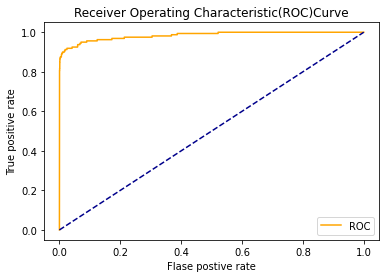

In [91]:
plt.figure()
plt.plot(fpr,tpr,color='orange',label='ROC')
plt.plot([0,1],[0,1], color='darkblue', linestyle='--')
plt.xlabel('Flase postive rate')
plt.ylabel('True positive rate')
plt.title('Receiver Operating Characteristic(ROC)Curve')
plt.legend()
plt.show()

### DecisionTreeClassifier

In [92]:
dtc = DecisionTreeClassifier()
dtc.fit(X_train,y_train)
pred = dtc.predict(X_test)

In [93]:
cm=confusion_matrix(y_test,pred)
print(cm)
accuracy_score(y_test,pred)

[[85038   245]
 [   32   128]]


0.9967580726332175

In [94]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85283
           1       0.34      0.80      0.48       160

    accuracy                           1.00     85443
   macro avg       0.67      0.90      0.74     85443
weighted avg       1.00      1.00      1.00     85443



In [95]:
roc_auc=roc_auc_score(y_test,pred)

In [96]:
roc_auc

0.898563605876904

In [97]:
fpr,tpr,thresholds = roc_curve(y_test,dtc.predict_proba(X_test)[:,1])

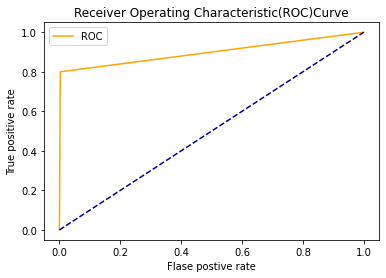

In [98]:
plt.figure()
plt.plot(fpr,tpr,color='orange',label='ROC')
plt.plot([0,1],[0,1], color='darkblue', linestyle='--')
plt.xlabel('Flase postive rate')
plt.ylabel('True positive rate')
plt.title('Receiver Operating Characteristic(ROC)Curve')
plt.legend()
plt.show()

### RandomForestClassifier

In [99]:
ran = RandomForestClassifier()
ran.fit(X_train,y_train)
pred = ran.predict(X_test)

In [100]:
cm=confusion_matrix(y_test,pred)
print(cm)
accuracy_score(y_test,pred)

[[85261    22]
 [   27   133]]


0.9994265182636377

In [101]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85283
           1       0.86      0.83      0.84       160

    accuracy                           1.00     85443
   macro avg       0.93      0.92      0.92     85443
weighted avg       1.00      1.00      1.00     85443



In [102]:
roc_auc=roc_auc_score(y_test,pred)

In [103]:
roc_auc

0.9154960176705791

In [104]:
fpr,tpr,thresholds = roc_curve(y_test,ran.predict_proba(X_test)[:,1])

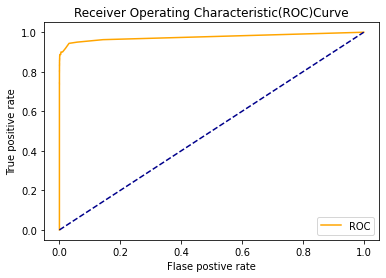

In [105]:
plt.figure()
plt.plot(fpr,tpr,color='orange',label='ROC')
plt.plot([0,1],[0,1], color='darkblue', linestyle='--')
plt.xlabel('Flase postive rate')
plt.ylabel('True positive rate')
plt.title('Receiver Operating Characteristic(ROC)Curve')
plt.legend()
plt.show()

### ExtraTreesClassifier

In [106]:
#ExtraTreesClassifier 

etc=ExtraTreesClassifier()
etc.fit(X_train,y_train)
pred = etc.predict(X_test)

accuracy_score(y_test,pred)    # 0.99950

# Best model with overall good precision,recall, accuracy & F1 score off the models

0.9995084442259752

In [107]:
cm=confusion_matrix(y_test,pred)
print(cm)

[[85269    14]
 [   28   132]]


In [108]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85283
           1       0.90      0.82      0.86       160

    accuracy                           1.00     85443
   macro avg       0.95      0.91      0.93     85443
weighted avg       1.00      1.00      1.00     85443



In [109]:
roc_auc=roc_auc_score(y_test,pred)

In [110]:
roc_auc

0.9124179203358231

In [111]:
fpr,tpr,thresholds = roc_curve(y_test,etc.predict_proba(X_test)[:,1])

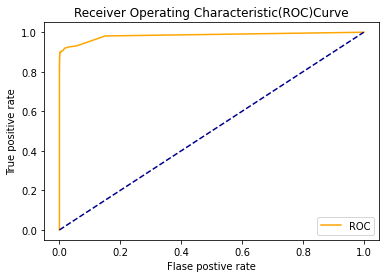

In [112]:
plt.figure()
plt.plot(fpr,tpr,color='orange',label='ROC')
plt.plot([0,1],[0,1], color='darkblue', linestyle='--')
plt.xlabel('Flase postive rate')
plt.ylabel('True positive rate')
plt.title('Receiver Operating Characteristic(ROC)Curve')
plt.legend()
plt.show()

### Hyperparametr tuning

In [113]:
#Hyperparametr tuning
from sklearn.model_selection import RandomizedSearchCV
param_grid = {
    'n_estimators': [i for i in range(50,100,120)],
    "criterion":["gini", "entropy", "log_loss"]}
rand = RandomizedSearchCV(etc, param_grid, cv=10, random_state = 0)
rand.fit(X_train, y_train)

RandomizedSearchCV(cv=10, estimator=ExtraTreesClassifier(),
                   param_distributions={'criterion': ['gini', 'entropy',
                                                      'log_loss'],
                                        'n_estimators': [50]},
                   random_state=0)

In [115]:
# print best parameter after tuning
print(rand.best_params_)
# print how our model looks after hyper-parameter tuning
print(rand.best_estimator_)

{'n_estimators': 50, 'criterion': 'log_loss'}
ExtraTreesClassifier(criterion='log_loss', n_estimators=50)


In [117]:
etcH=ExtraTreesClassifier(criterion='log_loss', n_estimators=50)
etcH.fit(X_train,y_train)
pred = etcH.predict(X_test)

accuracy_score(y_test,pred)    

0.9994967405170698

In [118]:
cm=confusion_matrix(y_test,pred)
print(cm)

[[85266    17]
 [   26   134]]


In [119]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85283
           1       0.89      0.84      0.86       160

    accuracy                           1.00     85443
   macro avg       0.94      0.92      0.93     85443
weighted avg       1.00      1.00      1.00     85443



In [120]:
roc_auc_score(y_test,pred)

0.9186503318363567

In [121]:
fpr,tpr,thresholds = roc_curve(y_test,etcH.predict_proba(X_test)[:,1])

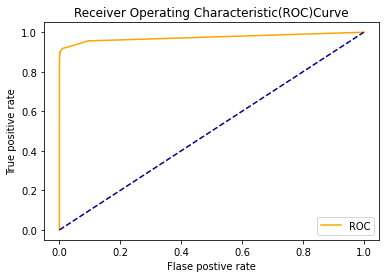

In [122]:
plt.figure()
plt.plot(fpr,tpr,color='orange',label='ROC')
plt.plot([0,1],[0,1], color='darkblue', linestyle='--')
plt.xlabel('Flase postive rate')
plt.ylabel('True positive rate')
plt.title('Receiver Operating Characteristic(ROC)Curve')
plt.legend()
plt.show()

- The Best model for credit card fradulent is ExtraTreesClassifier
- This model produce good precision,recall and F1 score when compare to other models.
- In this dataset the data is imbalenced so we are not considering the Accuracy score. 
- Using imblearn.over_sampling-SMOTE method to balance the imbalanced data